In [1]:
import numpy as np
import os
from shutil import copyfile
import shutil
import matplotlib.pyplot as plt
import cv2
import random
from pathlib import Path
import time
import glob
import math
from tqdm import tqdm
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F

from train_consecutive_images import wrapped_main_func, run_on_imagenet_image


device = torch.device("cuda:2")


#### configs 

In [3]:
config_path = "./configs/image_config.yaml"
example_config_name = f"template.yaml"

#### Example

In [ ]:
image_path = glob.glob("/mnt/raid/home/eyal_michaeli/datasets/imagenet_10k/imagenet_images/*/*.jpg")[random.randint(0, 1000)]
n_epochs = 300
run_on_imagenet_image(image_path, config_path, example_config_name, n_epochs, text_config_dict=None, device=device)

#### test bootstrap epoch effect
#### Conclusion: doesn't matter much

bootstrap_epoch: 200


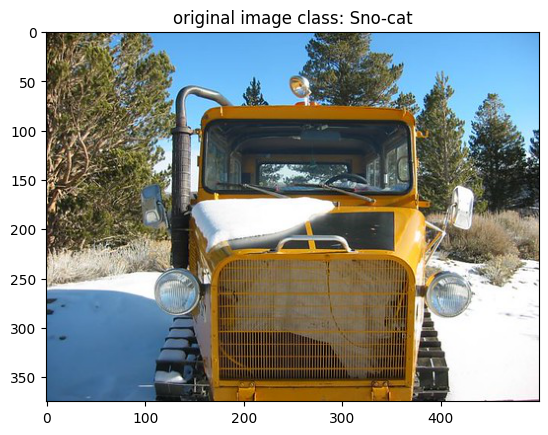

device: cuda:2
running with seed: 1.


  0%|          | 0/400 [00:00<?, ?it/s]/mnt/raid/home/eyal_michaeli/anaconda3/envs/text2live/lib/python3.9/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
100%|██████████| 400/400 [02:58<00:00,  2.24it/s]


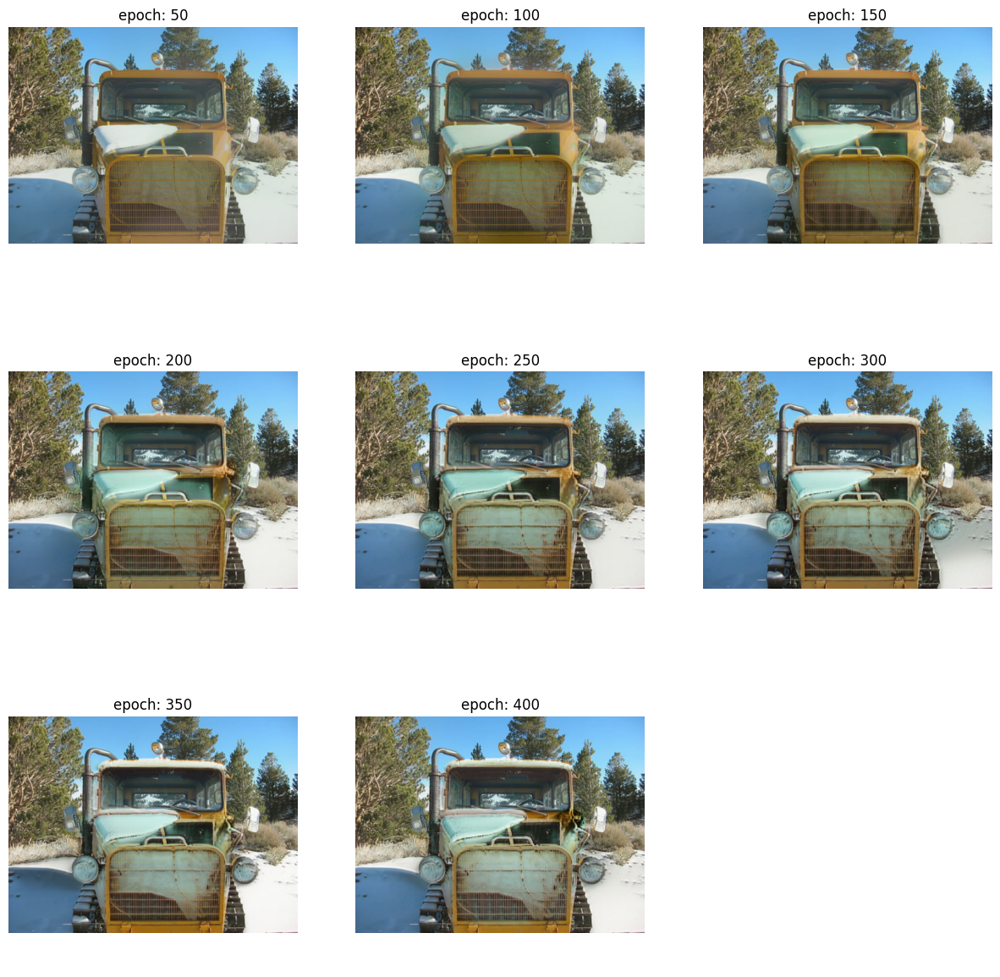




bootstrap_epoch: 400


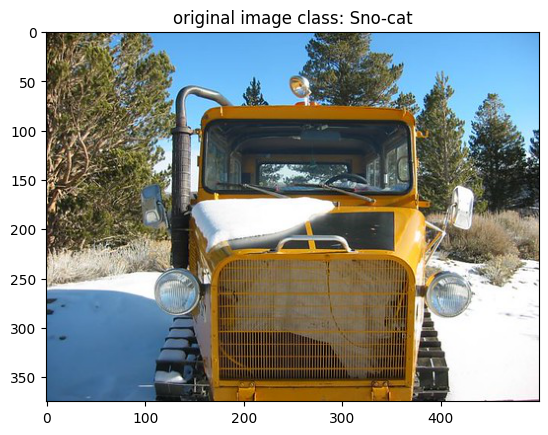

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:56<00:00,  2.26it/s]


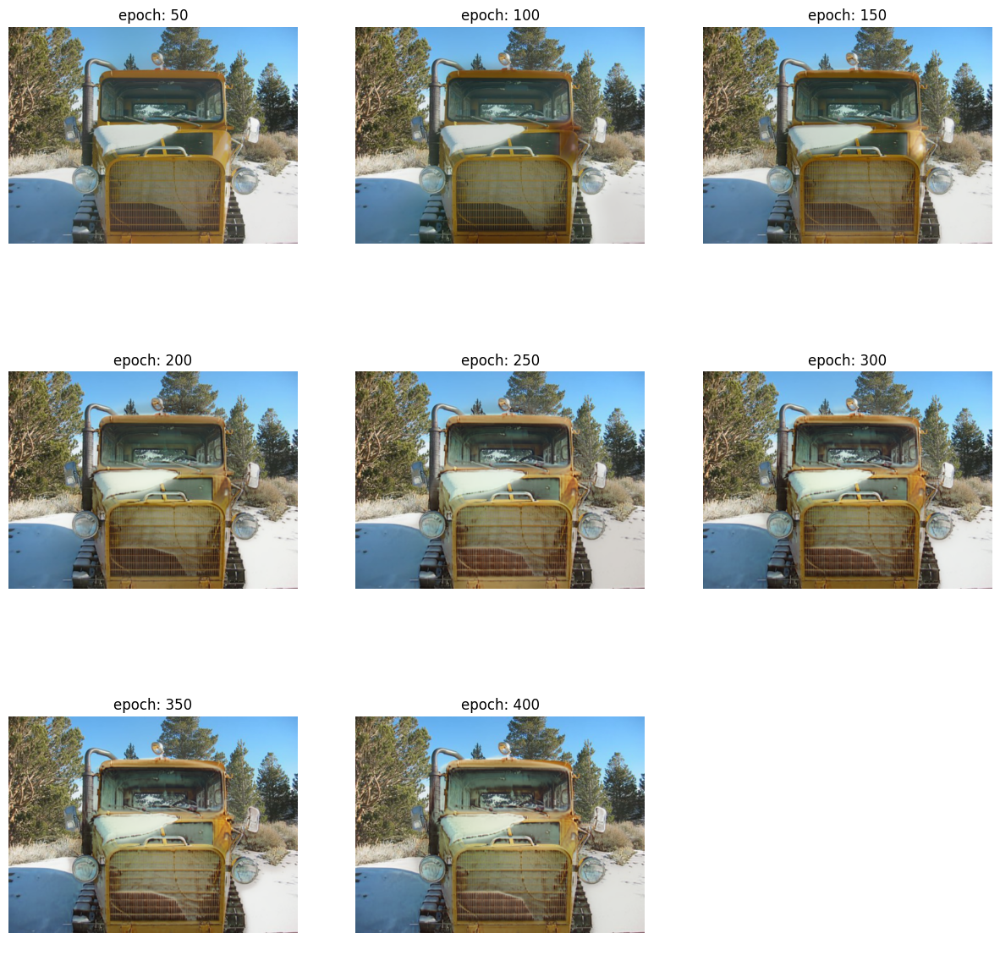




bootstrap_epoch: 600


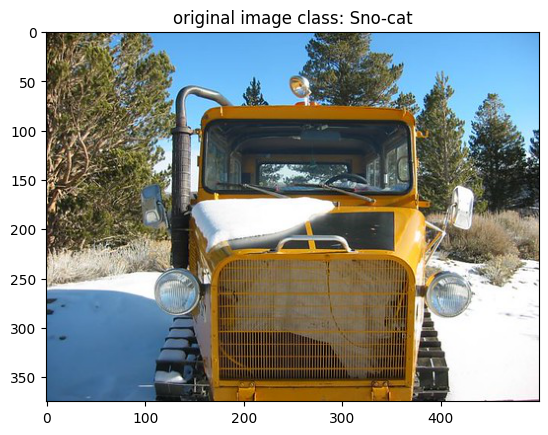

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:55<00:00,  2.28it/s]


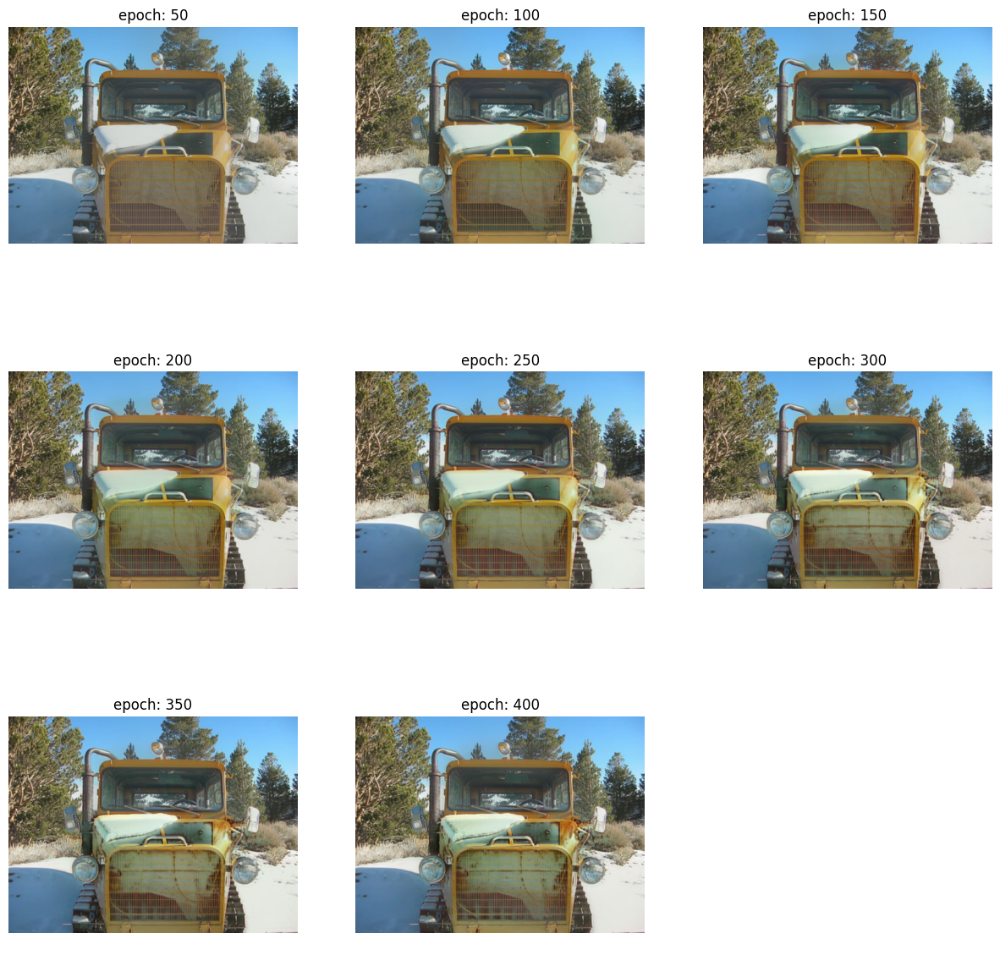




bootstrap_epoch: 800


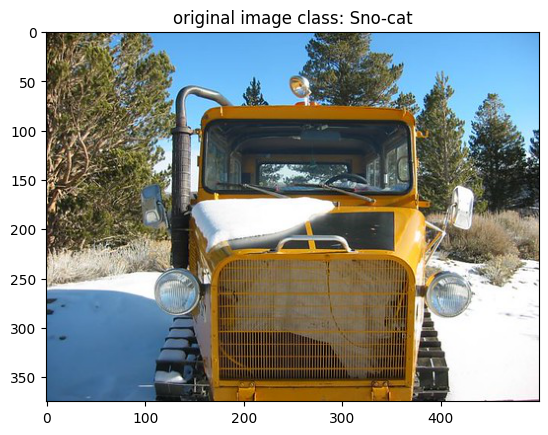

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:59<00:00,  2.23it/s]


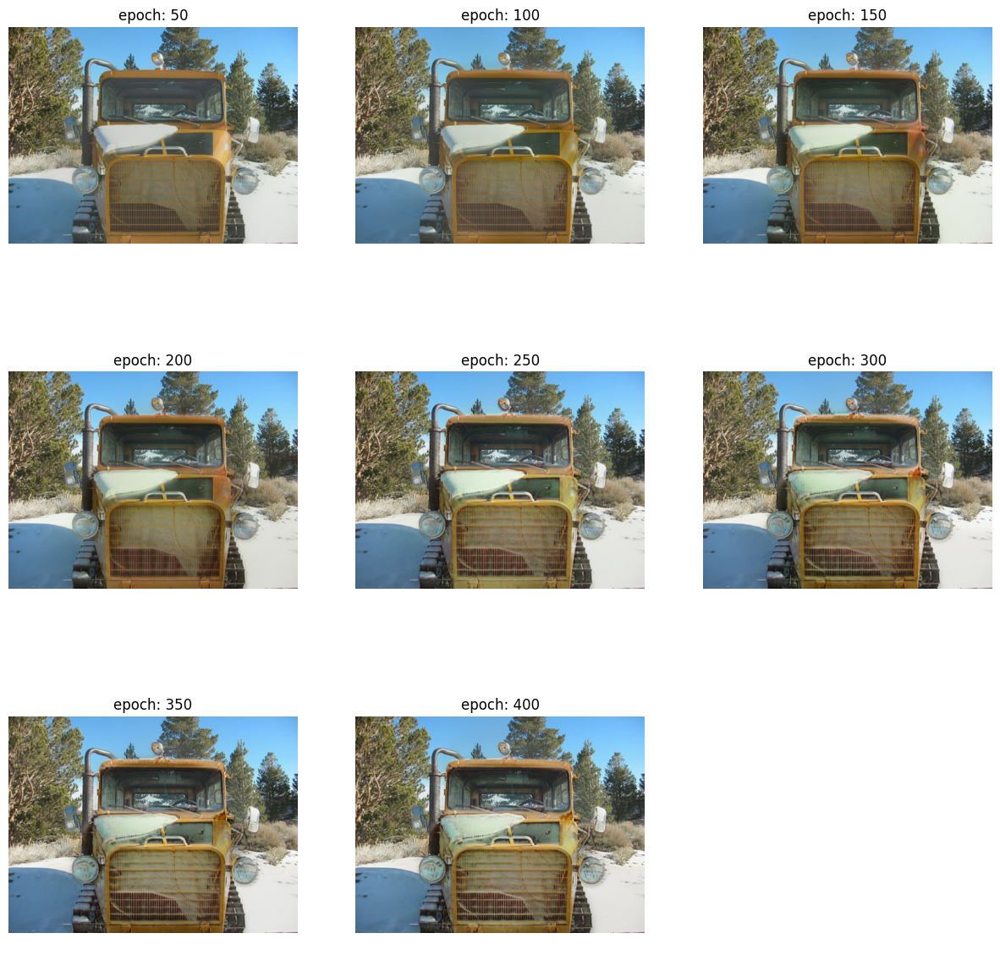




bootstrap_epoch: 1000


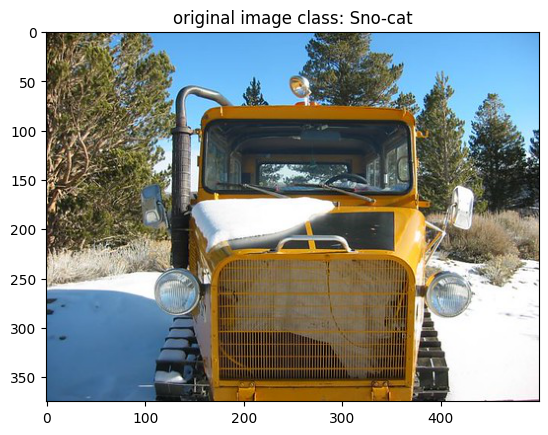

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [03:00<00:00,  2.21it/s]


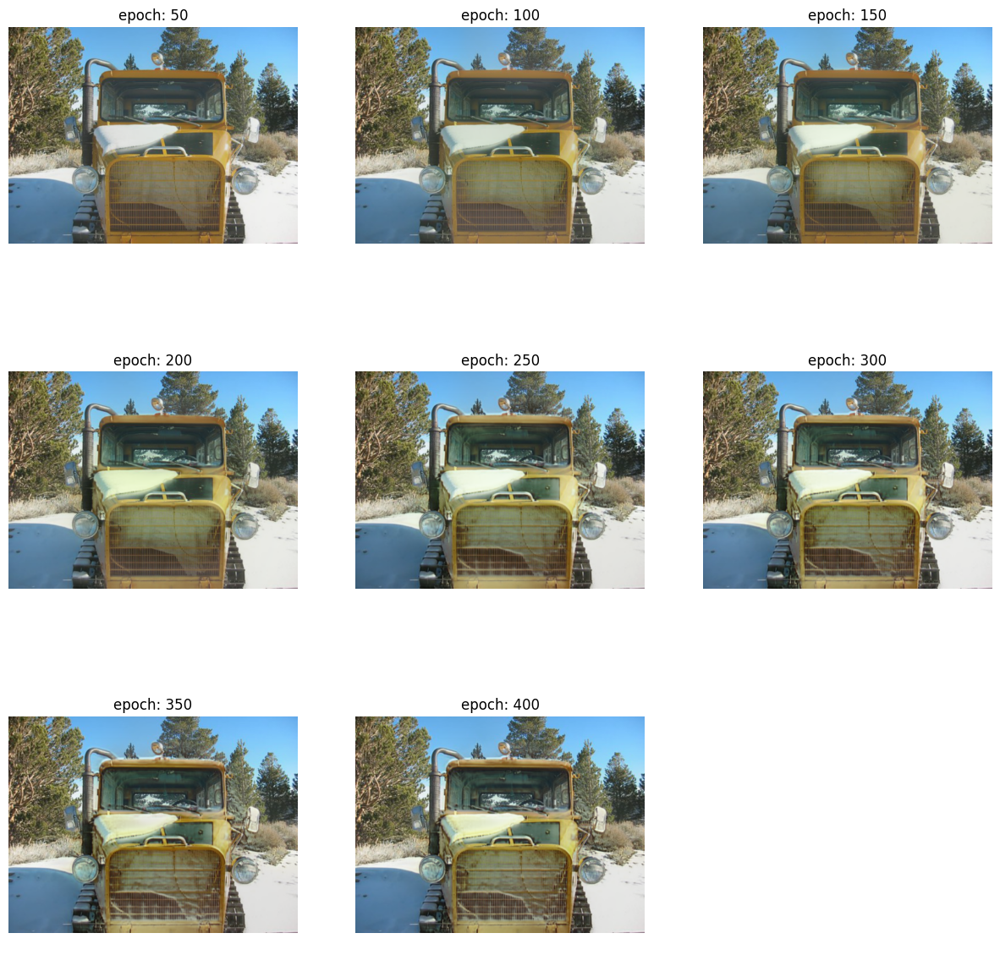

In [4]:
image_path = glob.glob("/mnt/raid/home/eyal_michaeli/datasets/imagenet_10k/imagenet_images/*/*.jpg")[random.randint(0, 1000)]
class_name = Path(image_path).parent.name
extra_string_for_model = "old"
n_epochs = 400

bootstrap_epochs_to_choose_from = [200, 400, 600, 800, 1000]
for bootstrap_epoch in bootstrap_epochs_to_choose_from:
    text_config_dict = {
                'image_path': image_path,
                'screen_text': f'{extra_string_for_model} {class_name}', 
                'comp_text': f'a {extra_string_for_model} {class_name}',
                'src_text': class_name,
                'bootstrap_text': class_name,
                'bootstrap_epoch': bootstrap_epoch
            }
    print(f"bootstrap_epoch: {bootstrap_epoch}")
    wrapped_main_func(config_path, example_config_name, text_config_dict, n_epochs, visualize=True, device=device)
    print("\n\n")


#### test text aug effect
#### Seems to have a significant effect; Use it

text_aug: a photo of 


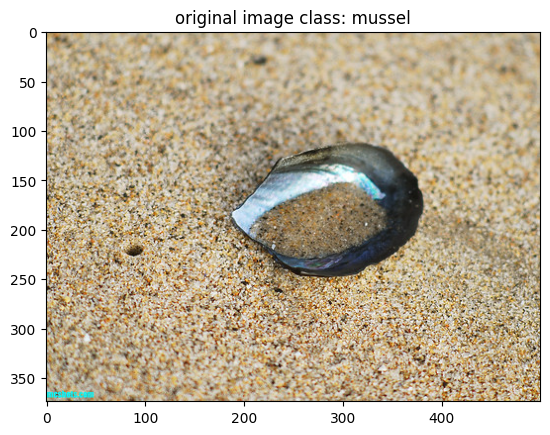

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:51<00:00,  2.34it/s]


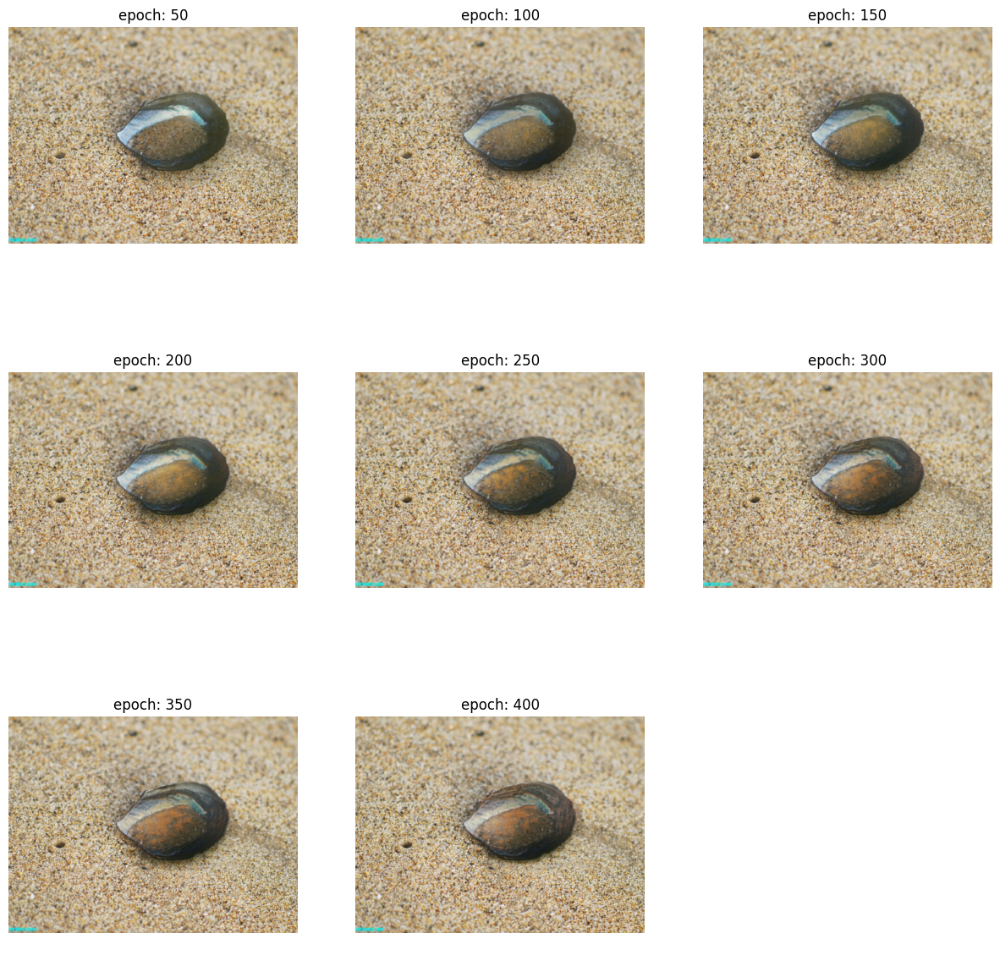




text_aug: the photo of 


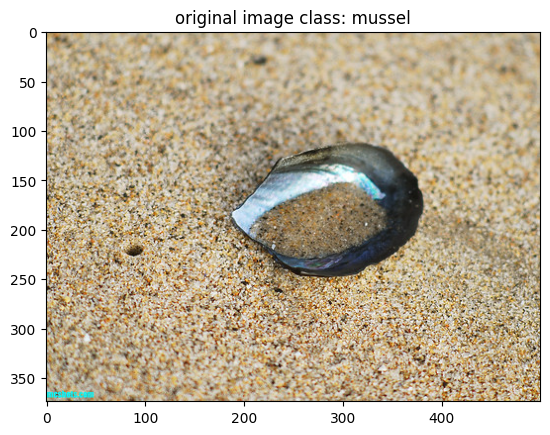

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:48<00:00,  2.38it/s]


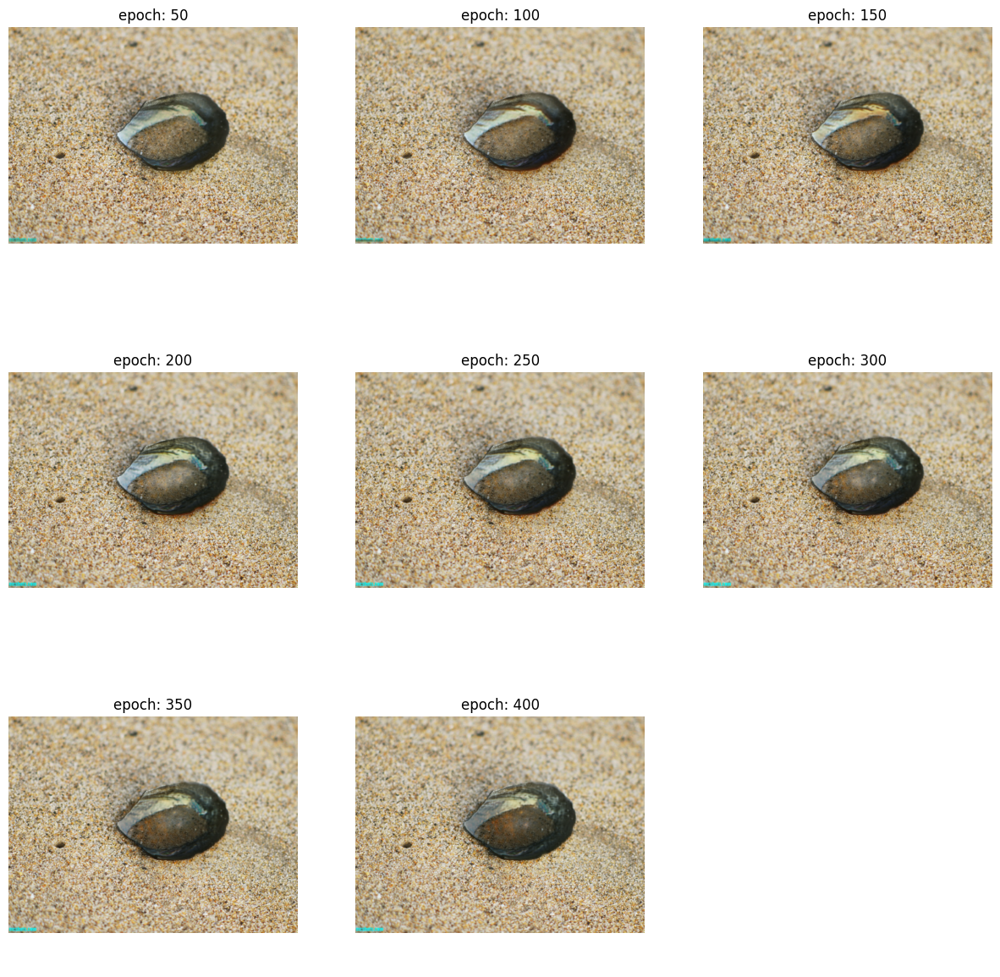




text_aug: image of 


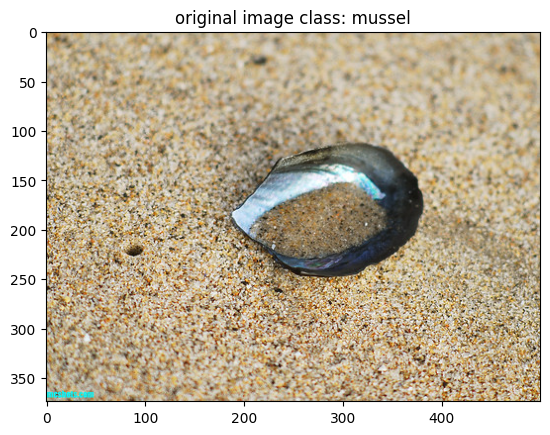

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:55<00:00,  2.28it/s]


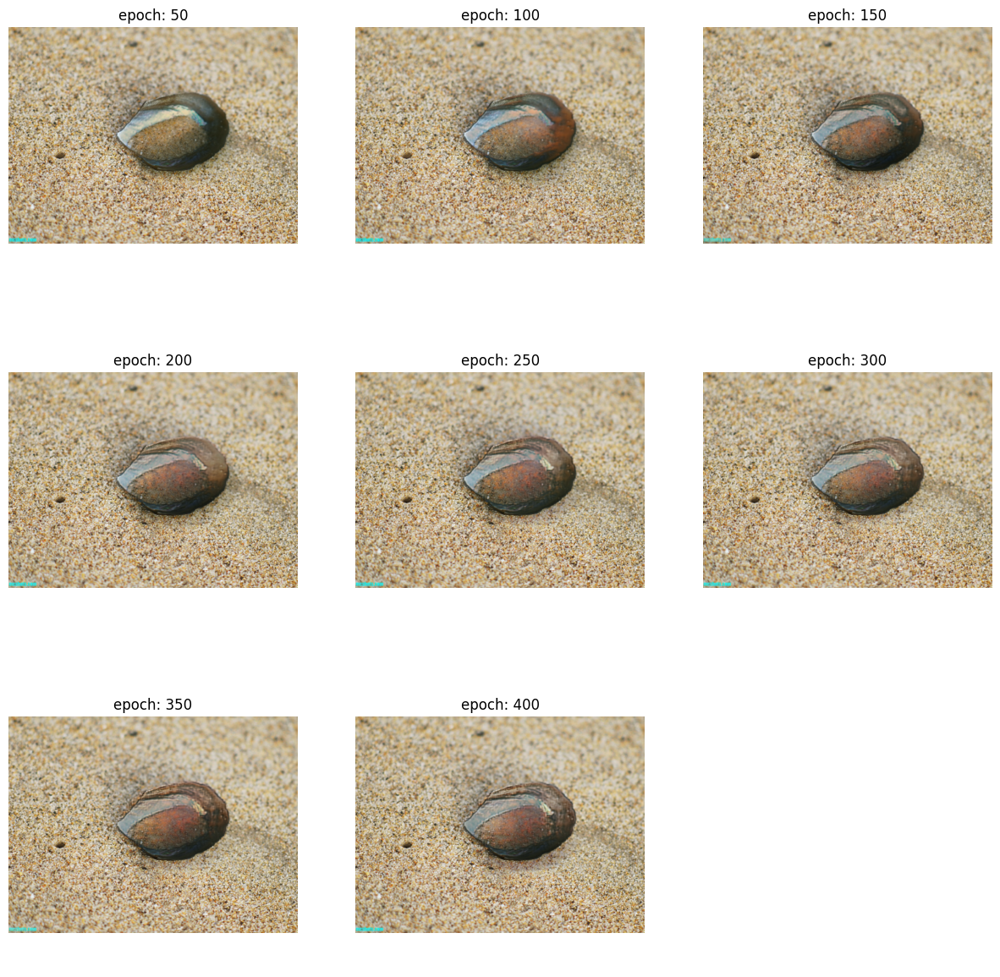




text_aug: an image of 


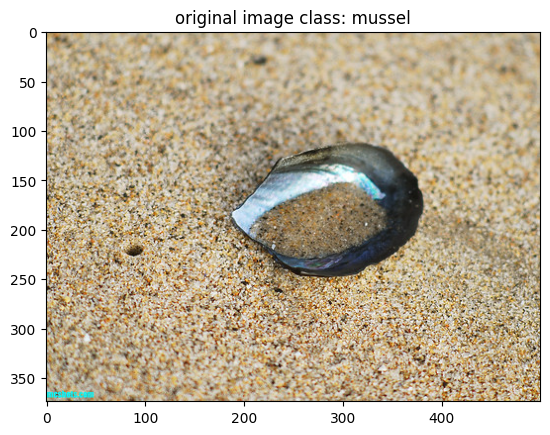

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:46<00:00,  2.41it/s]


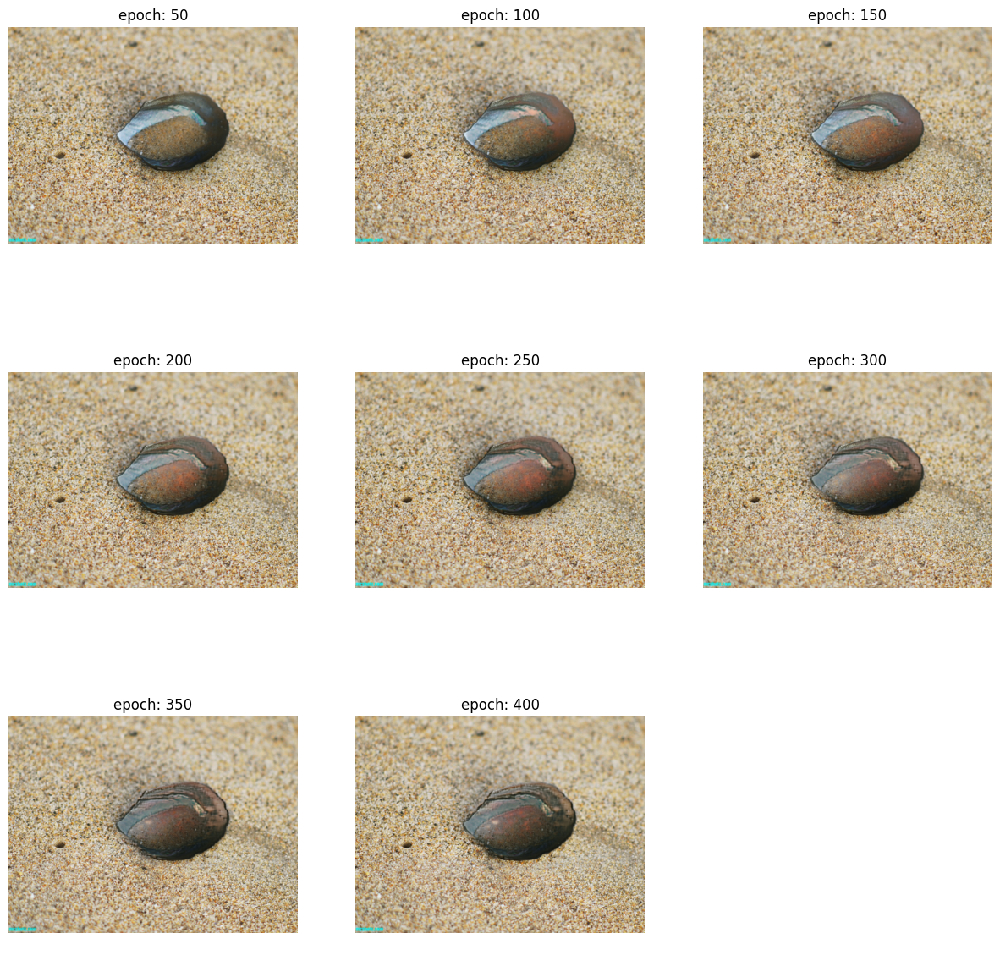




text_aug: high quality image of 


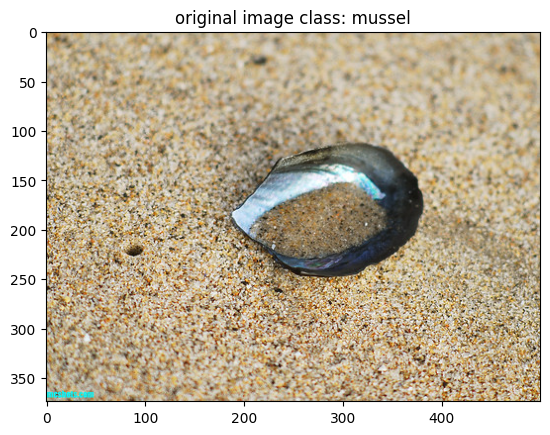

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:50<00:00,  2.35it/s]


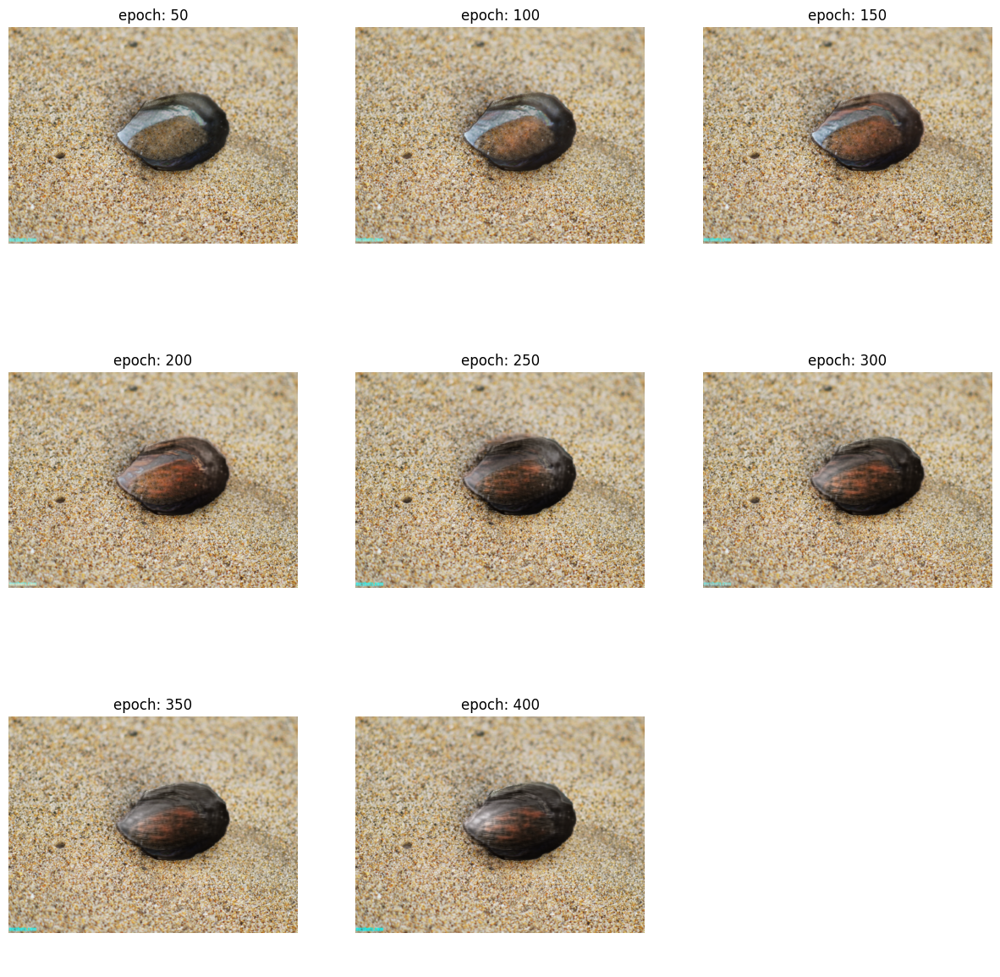




text_aug: a high quality image of 


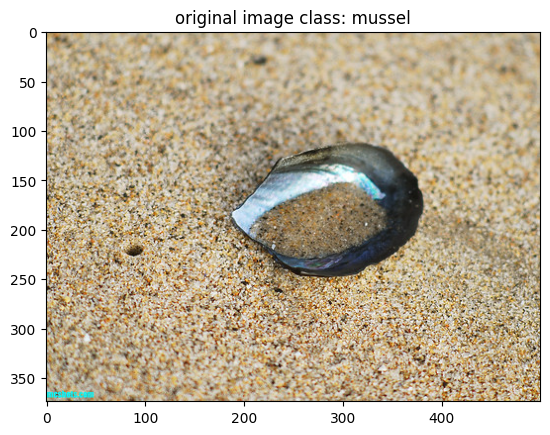

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:49<00:00,  2.36it/s]


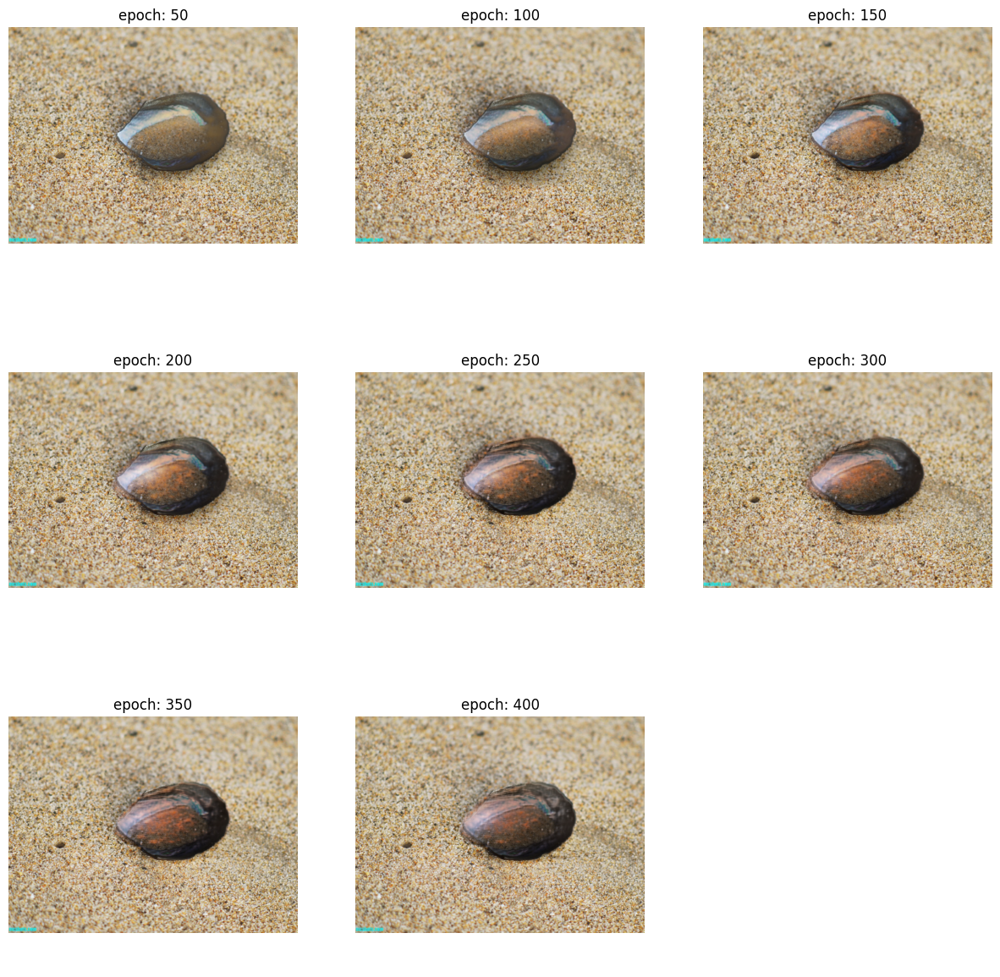




text_aug: the 


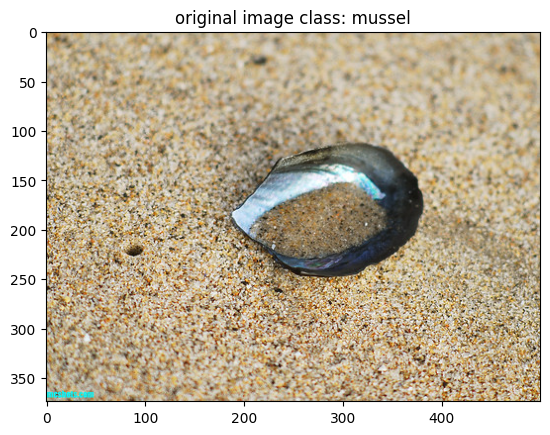

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:49<00:00,  2.36it/s]


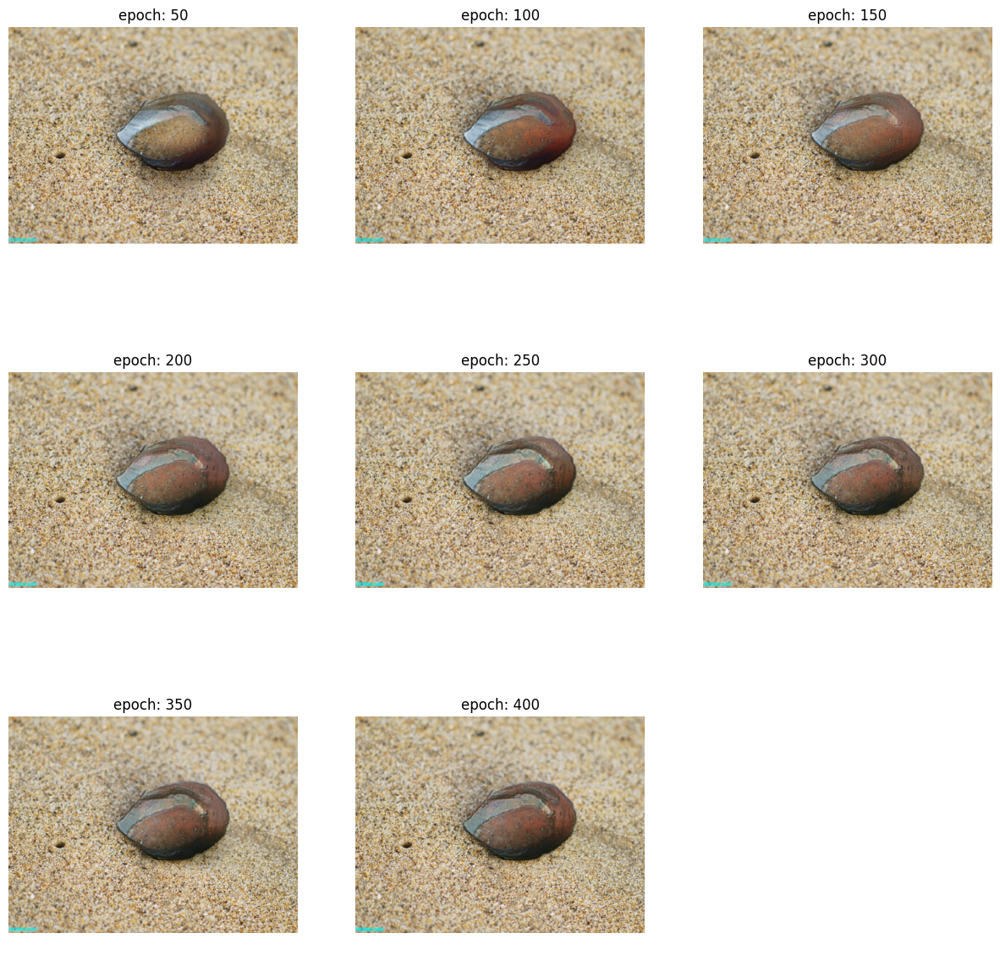




text_aug: a 


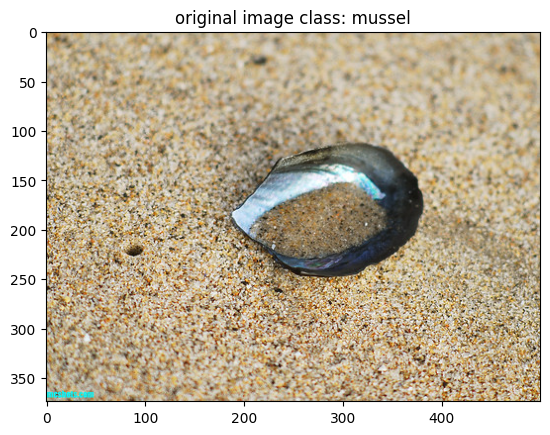

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:51<00:00,  2.34it/s]


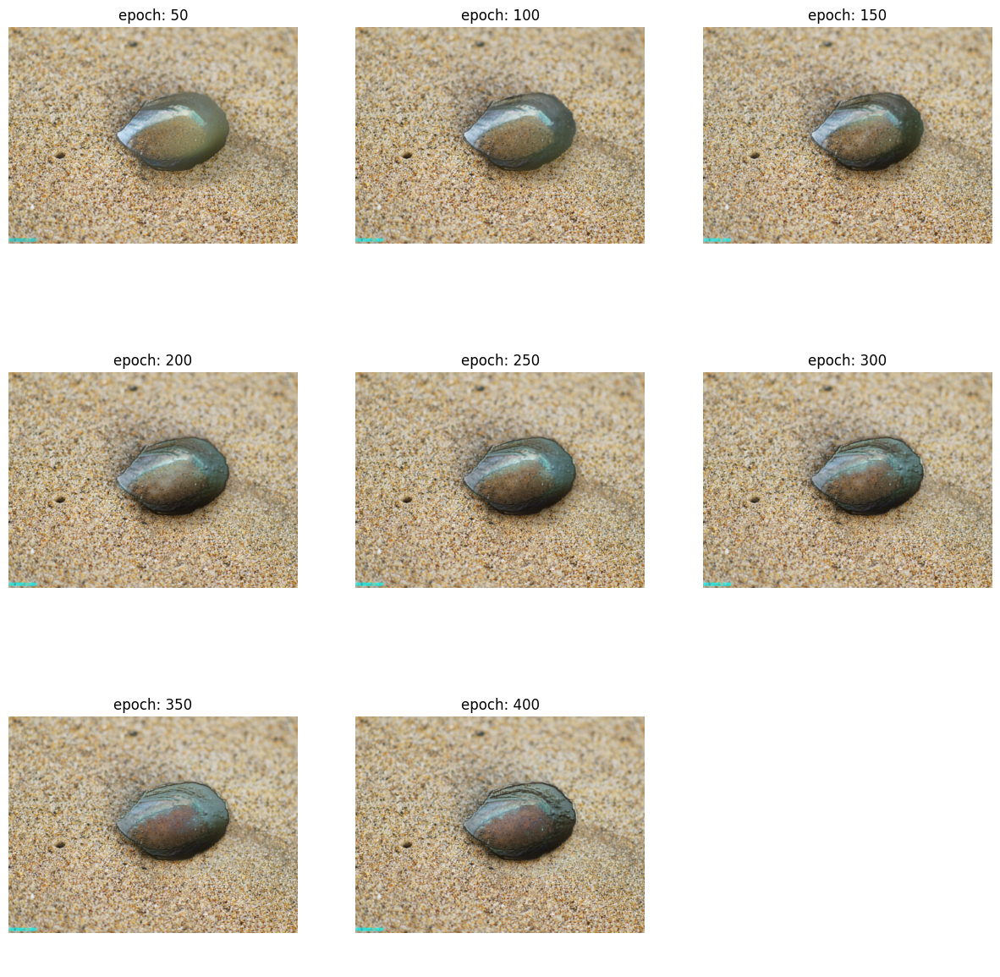




text_aug: an 


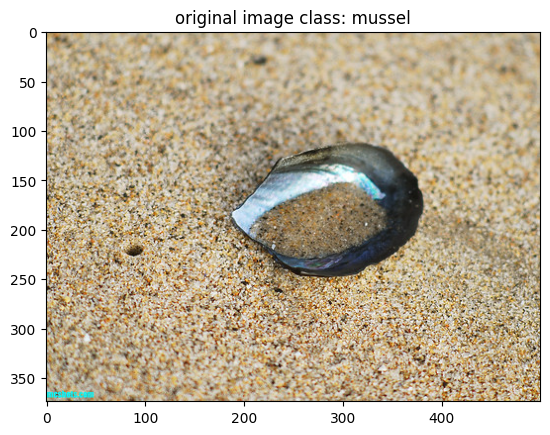

device: cuda:2
running with seed: 1.


100%|██████████| 400/400 [02:44<00:00,  2.43it/s]


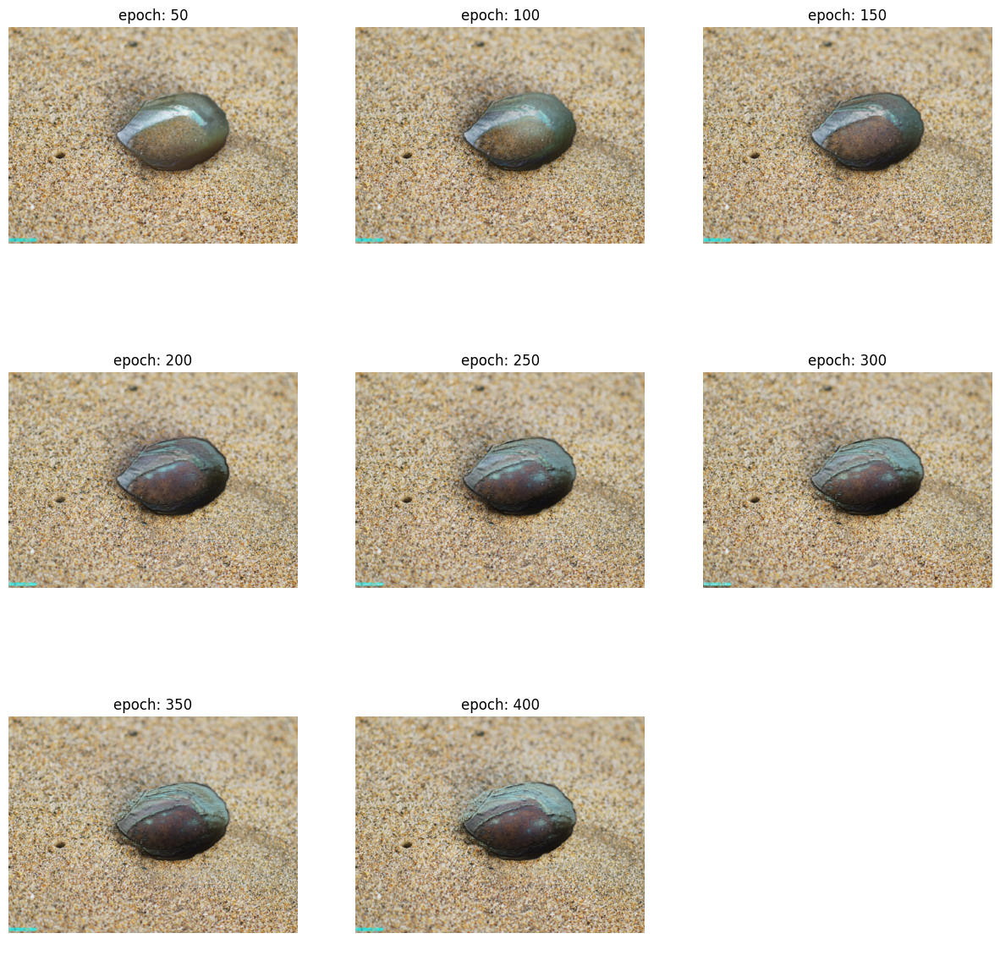

In [5]:
image_path = glob.glob("/mnt/raid/home/eyal_michaeli/datasets/imagenet_10k/imagenet_images/*/*.jpg")[random.randint(0, 1000)]
class_name = Path(image_path).parent.name
extra_string_for_model = "old"
n_epochs = 400

text_augs = ["a photo of ", "the photo of ", "image of ", "an image of ", "high quality image of ", 
                "a high quality image of ", "the ", "a ", "an "]  # got from the paper, page 19
for text_aug in text_augs:
    text_config_dict = {
                'image_path': image_path,
                'screen_text': f'{extra_string_for_model} {class_name}', 
                'comp_text': f'{text_aug} {extra_string_for_model} {class_name}',
                'src_text': class_name,
                'bootstrap_text': class_name,
                'bootstrap_epoch': random.choice([200, 300, 400, 500])
            }
    print(f"text_aug: {text_aug}")
    wrapped_main_func(config_path, example_config_name, text_config_dict, n_epochs, visualize=True, device=device)
    print("\n\n")

